In [1]:
import os, sys, time, tqdm, importlib, pickle, json
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import style
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from adjustText import adjust_text
import cmasher as cmr
import seaborn as sns
import scanpy as sc
import squidpy as sq
import scipy.stats as ss
import gseapy
import warnings
warnings.filterwarnings('ignore')
sys.path.append('../src')

style.use('seaborn-v0_8-white')
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

In [2]:
## data and res dir
xenium_data_dir = '../data/Xenium_LN'
openst_data_dir = '../data/OpenST_LN'
xenium_res_dir = '../results/Xenium_LN'
openst_res_dir = '../results/OpenST_LN'

In [3]:
## maps
with open('../data/maps/lymph_node_ct_name_map.json', 'r') as f:
    ct_name_dict = json.load(f)
with open('../data/maps/lymph_node_ct_cmap.json', 'r') as f:
    ct_cmap_dict = json.load(f)
with open('../data/maps/niche_cmap.json', 'r') as f:
    niche_cmap_dict = json.load(f)
cmap_niche = mpl.colors.LinearSegmentedColormap.from_list("cmap_niche", list(niche_cmap_dict.values()), N=len(niche_cmap_dict))
cmap_ct = mpl.colors.LinearSegmentedColormap.from_list("cmap_ct", list(ct_cmap_dict.values()), N=len(ct_cmap_dict))

In [4]:
## data after qc
crop1 = sc.read(f"{xenium_data_dir}/crop1.h5ad")
crop2 = sc.read(f"{xenium_data_dir}/crop2.h5ad")
crop3 = sc.read(f'{openst_data_dir}/openst.h5ad')
print(f'Crop1: {len(crop1)} cells.')
print(f'Crop2: {len(crop2)} cells.')
print(f'OpenST: {len(crop3)} cells.')

Crop1: 80534 cells.
Crop2: 74851 cells.
OpenST: 82518 cells.


In [31]:
all_cts = crop1.obs.cell_type.cat.categories
all_subcts = crop1.obs.sub_cell_type.cat.categories
print(f'{len(all_cts)} major cell types, {len(all_subcts)} sub cell types.')

13 major cell types, 30 sub cell types.


In [6]:
import niche_detection
importlib.reload(niche_detection)
from niche_detection import nichescope

In [7]:
import utils
importlib.reload(utils)
from utils import *

# B cell niche detection
Run NicheScope with B cell as target cell type on the three datasets: Xenium lymph node crop 1,2 and OpenST lymph node data.

In [8]:
target_ct = 'B'
sigma = 20
cca_comp = 10
px = 0.6
pz = 0.5

## Xenium crop 1

In [9]:
## run nichescope
meta1 = nichescope(crop1, 
                   target_ct, 
                   sigma=sigma, 
                   cov_test_null=True,
                   cca_comp=cca_comp, 
                   px=px, 
                   pz=pz)

[2025-07-25 11:54:29] [nichescope] [INFO] Dataset summary: 80534 cells, 4622 genes.
[2025-07-25 11:54:29] [nichescope] [INFO] 13 cell types: ['B', 'B_mem', 'B_plasma', 'DC', 'Endo', 'FDC', 'ILC', 'Macrophaeges', 'Myeloids', 'NK', 'Stromal', 'T', 'T_naive'].

[2025-07-25 11:54:34] [nichescope] [INFO] Computed neighborhood composition matrix N of shape (7036, 13).
[2025-07-25 11:54:38] [nichescope] [INFO] Nonneg CCA cors: [0.581 0.758 0.419 0.462 0.    0.448 0.538 0.    0.366 0.   ]

[2025-07-25 11:54:39] [nichescope] [INFO] NicheScope on B: Finished in 10.0s.


In [10]:
## save result
with open(f'{xenium_res_dir}/crop1_{target_ct}.pkl', 'wb') as f:
    pickle.dump(meta1, f)

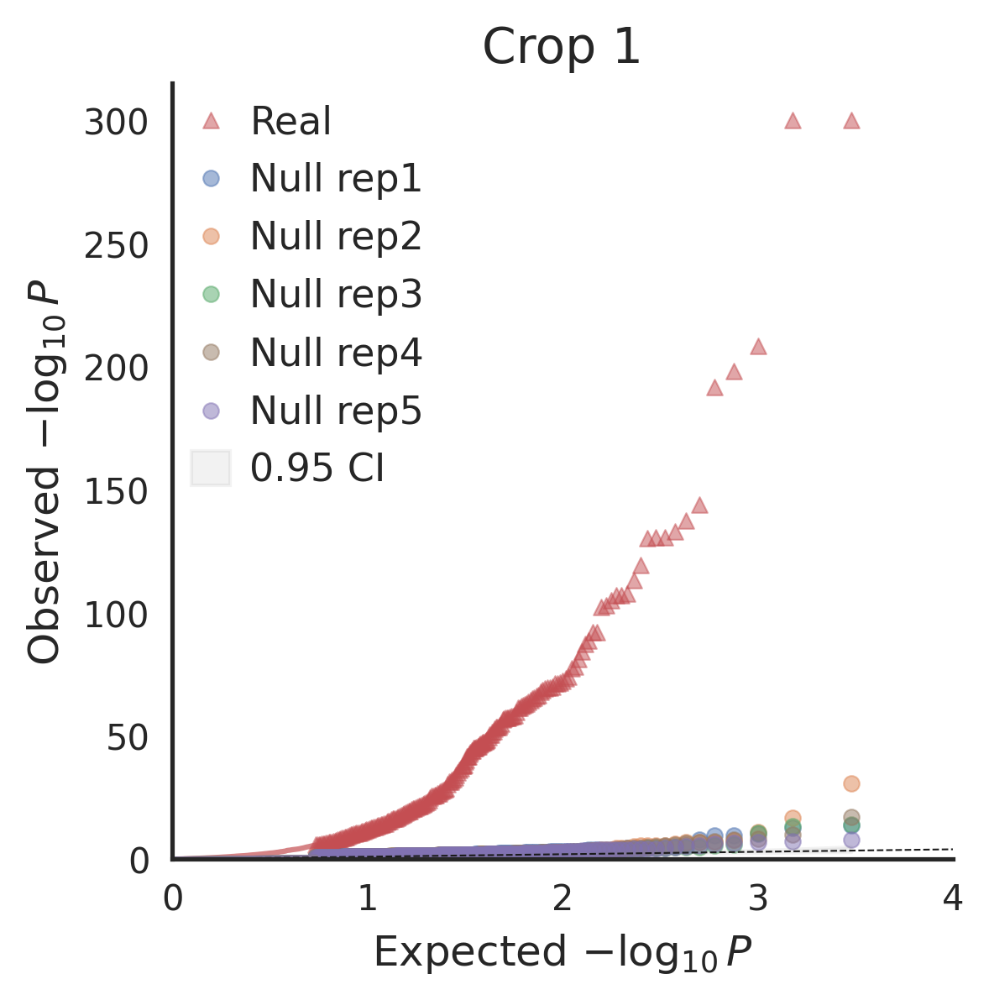

In [11]:
## cov test qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=300)
qqplot(meta1['cov_real_null'], ['Real']+[f'Null rep{i}' for i in range(1,6)], ms=20,
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['^','o','o','o','o','o'], 
       distribution='beta', ax=ax, title='Crop 1')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

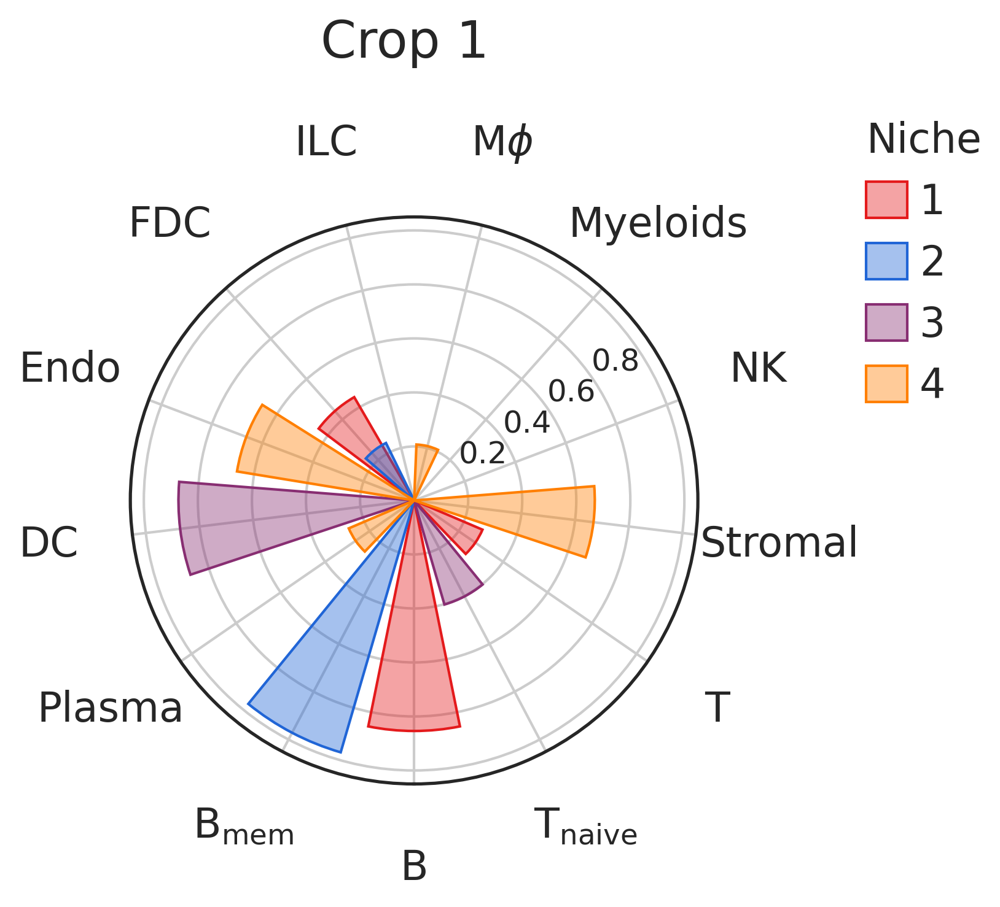

In [12]:
## representative cell niches: V radar plot
vdf1 = meta1['vdf']
comps1 = [2, 7, 3, 1]
colors = [cmap_niche(i) for i in range(4)]
xticklabels = [ct_name_dict[x] for x in vdf1.index.tolist()]
draw_v_radar(vdf1, comps1, v_thres=0.2, colors=colors, alpha=0.8, width=0.4, offset=0.07, 
             xticklabels=xticklabels, rlabel_angle=235, figsize=(4,4), dpi=300, xtick_fs=16, xlabel_pad=20, 
             ylim=(0,1.05), yticks=[0.2,0.4,0.6,0.8,1.0], yticklabels=['0.2','0.4','0.6','0.8',''], ytick_fs=12, 
             leg_loc='upper right', leg_pos=(1.5,1.17), leg_ncol=1, leg_title='Niche', leg_fs=16, leg_title_fs=16, 
             title='Crop 1', title_fs=20, title_y=1.15)


## Xenium crop 2

In [13]:
## run nichescope
meta2 = nichescope(crop2, 
                   target_ct, 
                   sigma=sigma, 
                   cov_test_null=True,
                   cca_comp=cca_comp, 
                   px=px, 
                   pz=pz)

[2025-07-25 11:54:49] [nichescope] [INFO] Dataset summary: 74851 cells, 4623 genes.
[2025-07-25 11:54:49] [nichescope] [INFO] 13 cell types: ['B', 'B_mem', 'B_plasma', 'DC', 'Endo', 'FDC', 'ILC', 'Macrophaeges', 'Myeloids', 'NK', 'Stromal', 'T', 'T_naive'].

[2025-07-25 11:54:53] [nichescope] [INFO] Computed neighborhood composition matrix N of shape (6101, 13).
[2025-07-25 11:54:57] [nichescope] [INFO] Nonneg CCA cors: [0.576 0.659 0.486 0.456 0.289 0.461 0.46  0.482 0.    0.   ]

[2025-07-25 11:54:57] [nichescope] [INFO] NicheScope on B: Finished in 8.4s.


In [14]:
## save result
with open(f'{xenium_res_dir}/crop2_{target_ct}.pkl', 'wb') as f:
    pickle.dump(meta2, f)

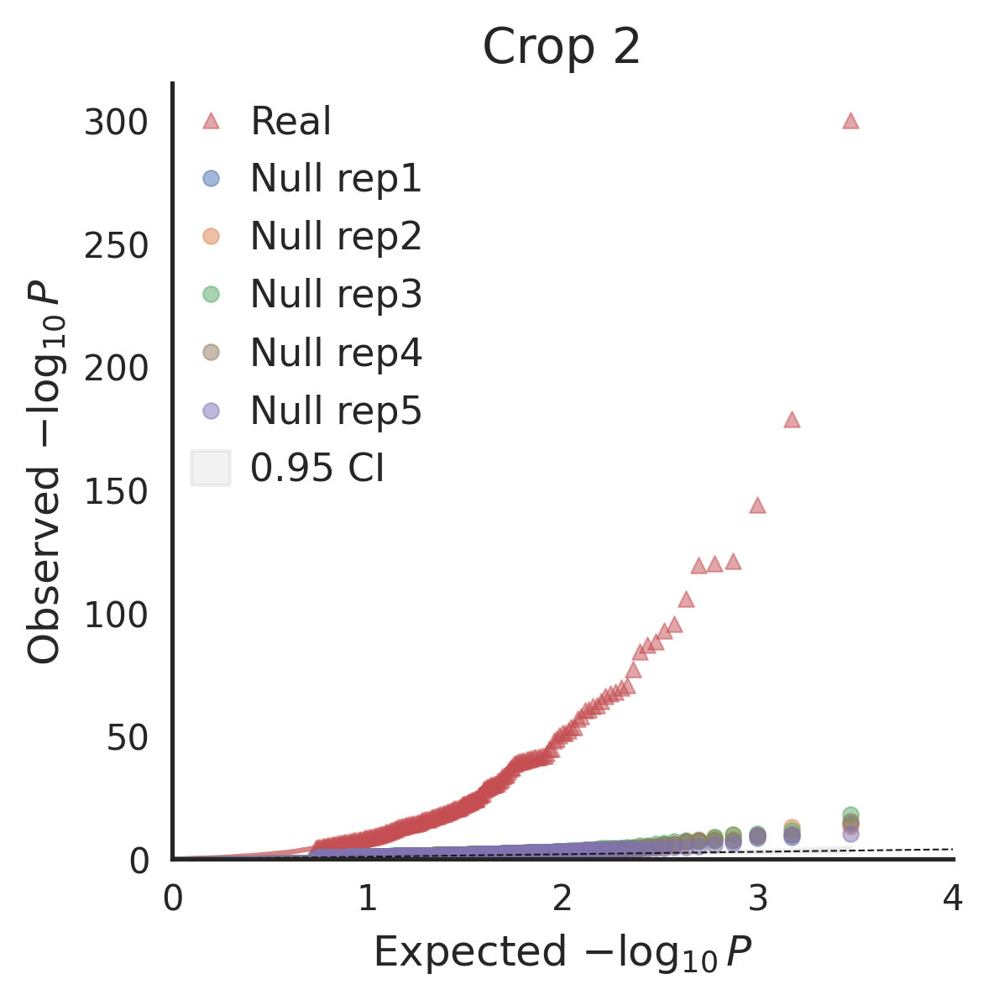

In [15]:
## cov test qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=300)
qqplot(meta2['cov_real_null'], ['Real']+[f'Null rep{i}' for i in range(1,6)], ms=20,
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['^','o','o','o','o','o'], 
       distribution='beta', ax=ax, title='Crop 2')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

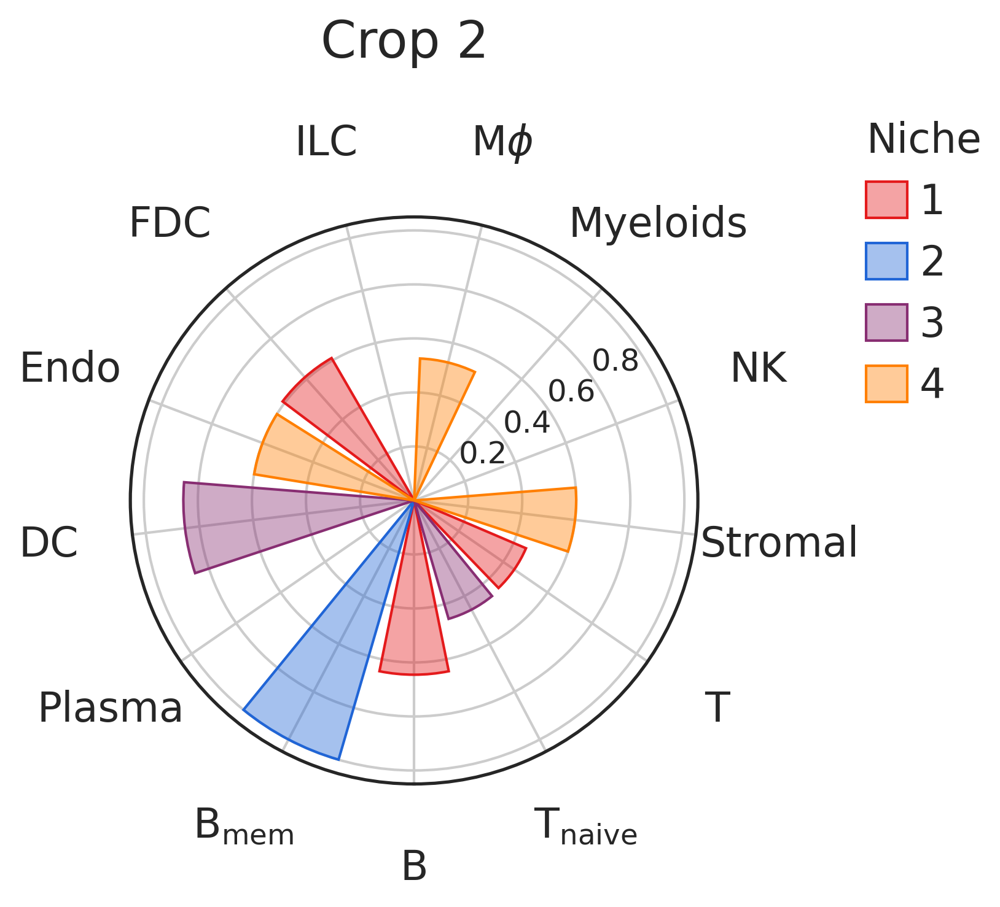

In [16]:
## representative cell niches: V radar plot
vdf2 = meta2['vdf']
comps2 = [2, 6, 3, 1]
colors = [cmap_niche(i) for i in range(4)]
xticklabels = [ct_name_dict[x] for x in vdf1.index.tolist()]
draw_v_radar(vdf2, comps2, v_thres=0.2, colors=colors, alpha=0.8, width=0.4, offset=0.07, 
             xticklabels=xticklabels, rlabel_angle=235, figsize=(4,4), dpi=300, xtick_fs=16, xlabel_pad=20, 
             ylim=(0,1.05), yticks=[0.2,0.4,0.6,0.8,1.0], yticklabels=['0.2','0.4','0.6','0.8',''], ytick_fs=12, 
             leg_loc='upper right', leg_pos=(1.5,1.17), leg_ncol=1, leg_title='Niche', leg_fs=16, leg_title_fs=16, 
             title='Crop 2', title_fs=20, title_y=1.15)


## OpenST

In [17]:
## run nichescope
meta3 = nichescope(crop3, 
                   target_ct, 
                   sigma=sigma, 
                   cov_test_null=True,
                   cca_comp=cca_comp, 
                   px=px, 
                   pz=pz)

[2025-07-25 11:54:58] [nichescope] [INFO] Dataset summary: 82518 cells, 4178 genes.
[2025-07-25 11:54:58] [nichescope] [INFO] 13 cell types: ['B', 'B_mem', 'B_plasma', 'DC', 'Endo', 'FDC', 'ILC', 'Macrophaeges', 'Myeloids', 'NK', 'Stromal', 'T', 'T_naive'].

[2025-07-25 11:55:07] [nichescope] [INFO] Computed neighborhood composition matrix N of shape (11136, 13).
[2025-07-25 11:55:13] [nichescope] [INFO] Nonneg CCA cors: [0.424 0.468 0.503 0.4   0.35  0.363 0.    0.261 0.199 0.232]

[2025-07-25 11:55:13] [nichescope] [INFO] NicheScope on B: Finished in 15.2s.


In [18]:
## save result
with open(f'{openst_res_dir}/openst_{target_ct}.pkl', 'wb') as f:
    pickle.dump(meta3, f)

# Main results
Analysis of B cell niche 1 and niche 2 across three datasets. Note: Niche 1/2 are not necessarily the first or second CCA components. They are GC-associated niches, and we named them as niche 1 and niche 2.

In [19]:
cov1, udf1, vdf1 = meta1['cov_target'], meta1['udf'], meta1['vdf']
cov2, udf2, vdf2 = meta2['cov_target'], meta2['udf'], meta2['vdf']
cov3, udf3, vdf3 = meta3['cov_target'], meta3['udf'], meta3['vdf']

## Candidate gene selection
Consistency of gene-level p-values in covariance tests on Xenium crop 1 and crop 2.

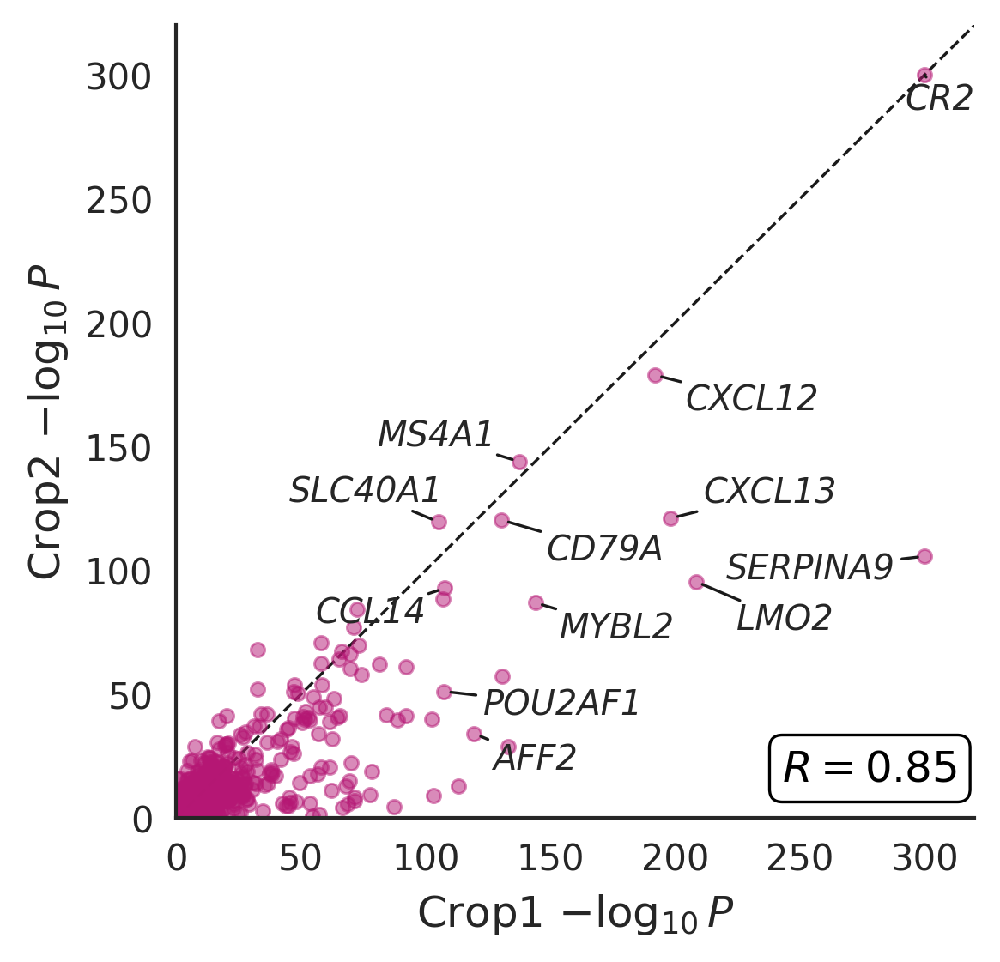

In [22]:
## p-value consistency
df = pd.merge(cov1, cov2, how='inner', on='gene_id')
sel_genes = ['SERPINA9', 'CR2', 'LMO2', 'CXCL12', 'CXCL13', 'MYBL2', 'MS4A1', 'CD79A', 'AFF2', 'CCL14', 'POU2AF1', 'SLC40A1']
x = -np.log10(df['vec_pval_x'])
y = -np.log10(df['vec_pval_y'])
r = ss.pearsonr(x, y)[0]

tick_font = 10
label_font = 12
color = '#b51774'
sns.set_theme(style="white")
sns.set_context('paper', font_scale=1.)

fig, ax = plt.subplots(1, 1, figsize=(4,4), dpi=300)
ax.axline((0,0), slope=1, linestyle='--', linewidth=0.8, color='k', zorder=1)
ax.scatter(x, y, marker='o', linewidths=0.7, edgecolor=color, facecolor=color, alpha=0.5, s=15)
font_ratio = {'family': 'sans',
              'style': 'italic',
        'color':  'black',
        'weight': 'normal',
        'size': label_font,
        'bbox': dict(boxstyle="round",
                   facecolor='white',
                   edgecolor='black',
                   lw=0.8
                   )
        }
ax.text(278, 20, f"$R={r:.2f}$", fontdict=font_ratio, horizontalalignment='center', verticalalignment='center')
ax.set_xlim(0,320)
ax.set_ylim(0,320)
ax.set_xticks(np.arange(0,310,50))
ax.set_yticks(np.arange(0,310,50))
ax.set_xlabel('Crop1 $-\log_{10} P$', fontsize=label_font)
ax.set_ylabel('Crop2 $-\log_{10} P$', fontsize=label_font)
ax.tick_params(axis='both', which='major', length=3, width=1, labelsize=tick_font)
# annotate top genes with low p-value
texts = []
for gene in sel_genes:
    row = df.loc[df.gene_id==gene]
    tx = -np.log10(row['vec_pval_x'].values[0])
    ty = -np.log10(row['vec_pval_y'].values[0])
    ha, va = 'left', 'top'
    if gene in ['MS4A1', 'SLC40A1']:
        ha, va = 'right', 'bottom'
    texts.append(ax.text(tx, ty, gene, ha=ha, va=va, fontdict={'family': 'sans', 'style': 'italic'}))
adjust_text(texts, force_text=(0.1,0.1), force_static=(0.2,0.2), expand=(1.5,1.5), arrowprops=dict(arrowstyle='-', color='k'))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

## Niche cell types: spatial distribution
Spatial distributions of main niche (sub-)cell types of B cell niche 1 and niche 2 across whole tissue section of each dataset.

In [72]:
def draw_niche_ct_spatial(crop, cts, cts_names, colors, ylabel=None, figsize=(8,8), invert_yaxis=True):

    fig, ax = plt.subplots(figsize=figsize, dpi=300)

    ## background
    for ct in all_subcts:
        if ct not in cts:
            points_ = crop.obs.loc[crop.obs['sub_cell_type']==ct].copy()
            ax.scatter(points_['x'], points_['y'], s=6, c='#F8F8F8', edgecolors='#F8F8F8', alpha=1, lw=0)
    ## niche cell types
    for ct, color in zip(cts, colors):
        if ct in all_cts:
            points_ = crop.obs.loc[crop.obs['cell_type']==ct].copy()
        else:
            points_ = crop.obs.loc[crop.obs['sub_cell_type']==ct].copy()
        ax.scatter(points_['x'], points_['y'], s=6, facecolors=color,edgecolors=color, alpha=0.7, lw=0.5, label=ct)
    
    ax.set_ylabel(ylabel, fontsize=24)
    ax.margins(0.01,0.01)
    if invert_yaxis:
        plt.gca().invert_yaxis()
    ax.set_xticks([])
    ax.set_yticks([])
    for s in ['top', 'bottom', 'right', 'left']:
        ax.spines[s].set_visible(False)

    leg = ax.legend(bbox_to_anchor=(0.5,1.02), loc='lower center', 
                    borderpad=0, borderaxespad=0, ncol=3,
                    framealpha=0, markerscale=4, fontsize=20, 
                    handletextpad=0.2, columnspacing=0.5)


In [60]:
cts = ['B_mem', 'FDC', 'T_CD4+_TfH_GC']
cts_names = [r'$\text{B}_{\text{mem}}$', 'FDC', 'Tfh']
colors = ['#7570b3', '#dbb57b', '#d41e96']

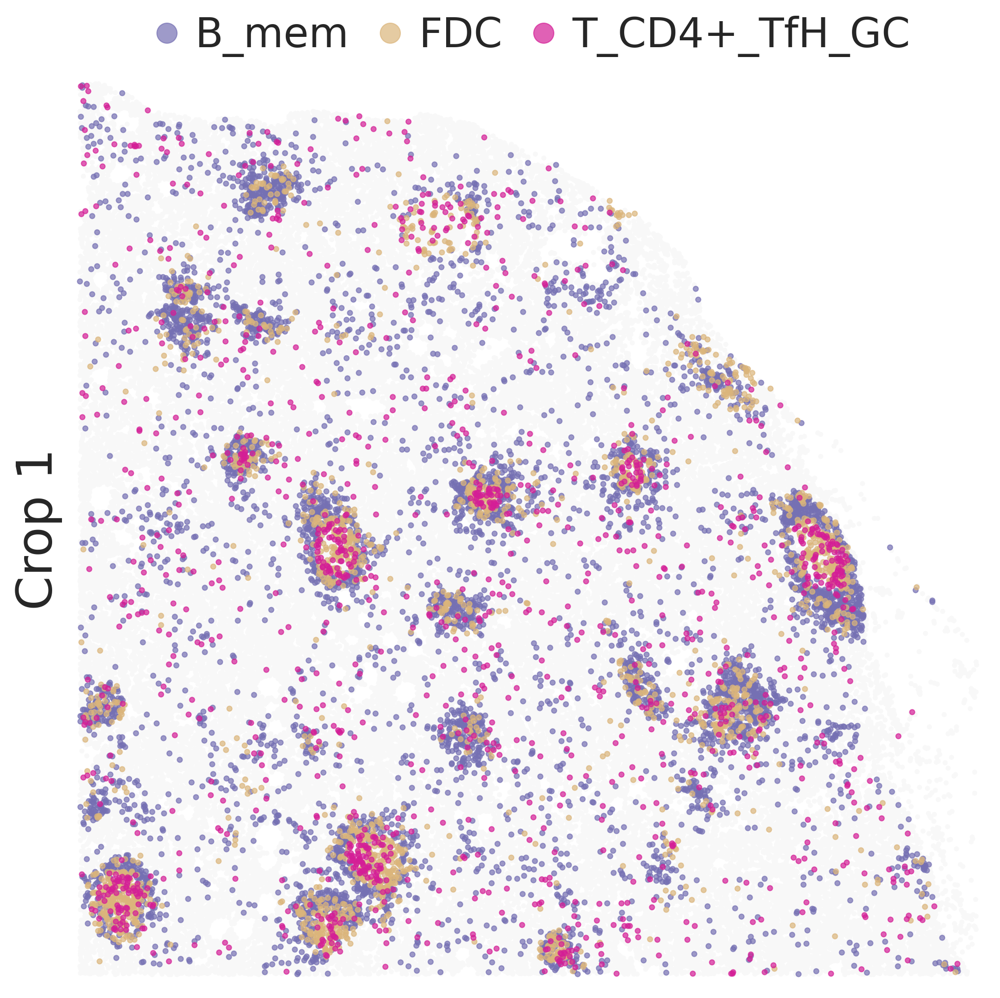

In [66]:
draw_niche_ct_spatial(crop1, cts, cts_names, colors, 'Crop 1')

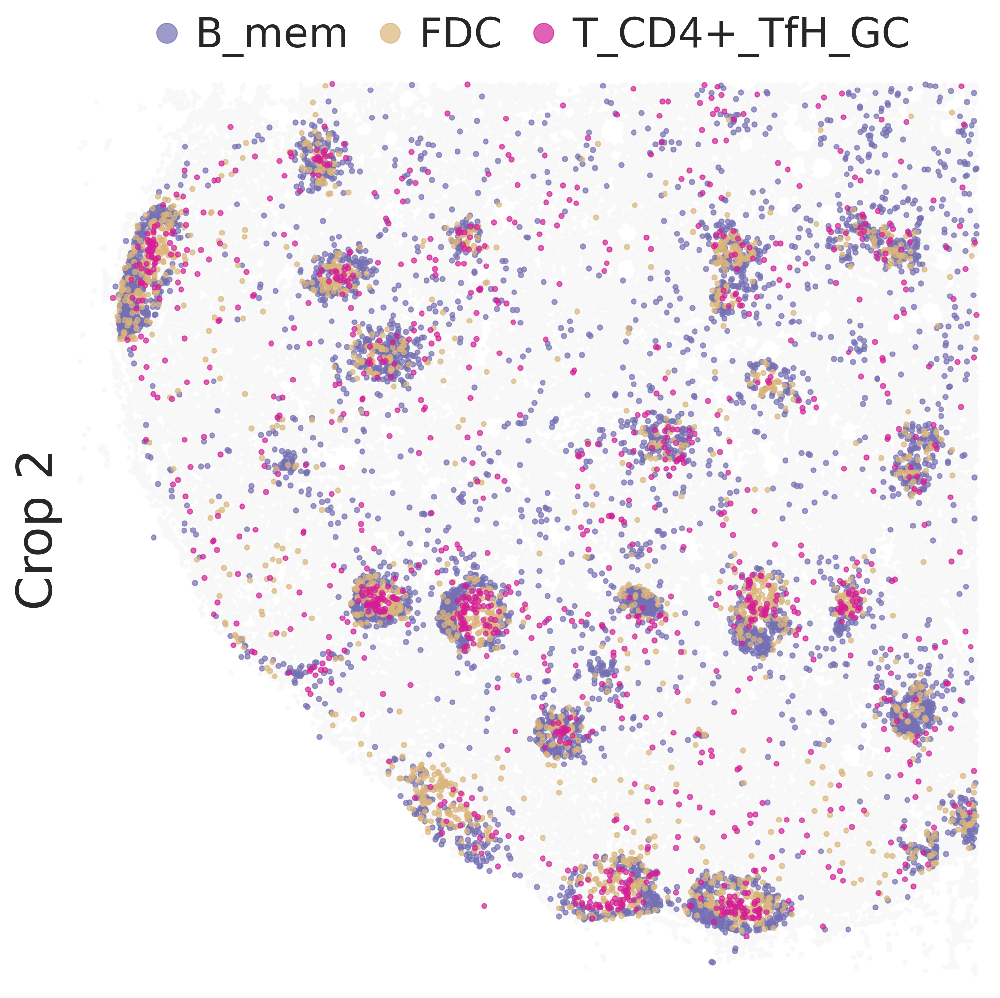

In [69]:
draw_niche_ct_spatial(crop2, cts, cts_names, colors, 'Crop 2')

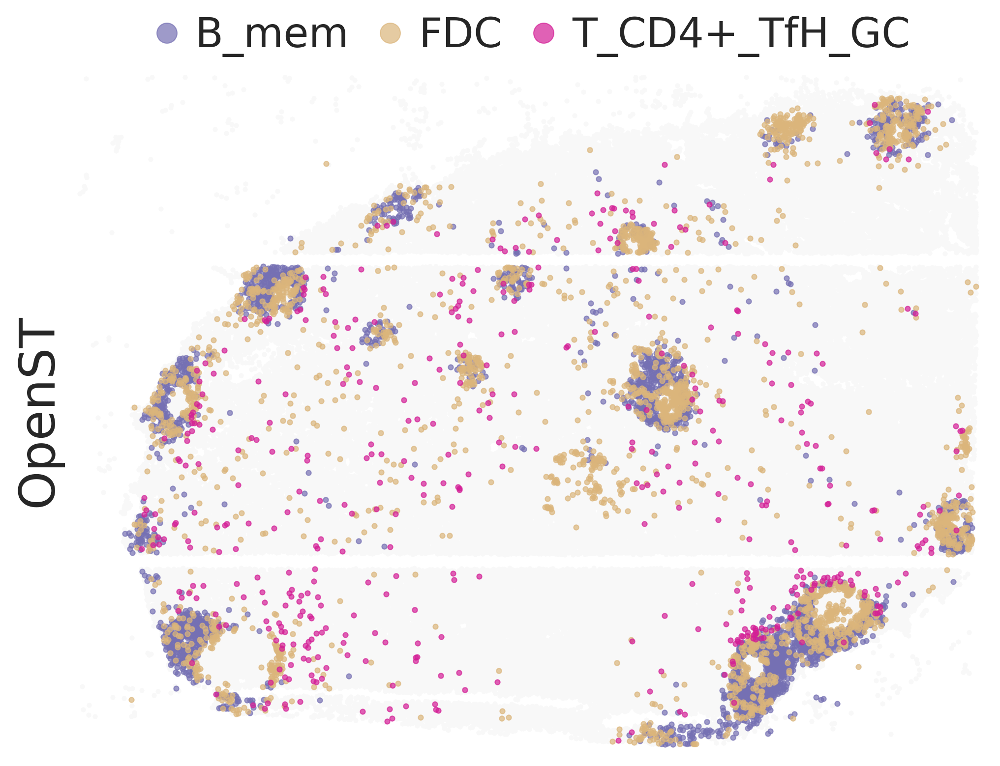

In [73]:
draw_niche_ct_spatial(crop3, cts, cts_names, colors, 'OpenST', figsize=(8,6), invert_yaxis=False)

## Niche score: spatial distribution
Spatial distribution of niche scores of B cell niche 1 and niche 2 on three datasets.

### Niche 1

In [81]:
cmap_niche_score = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche_score', ['#FFFFFF', cmap_niche(0)])

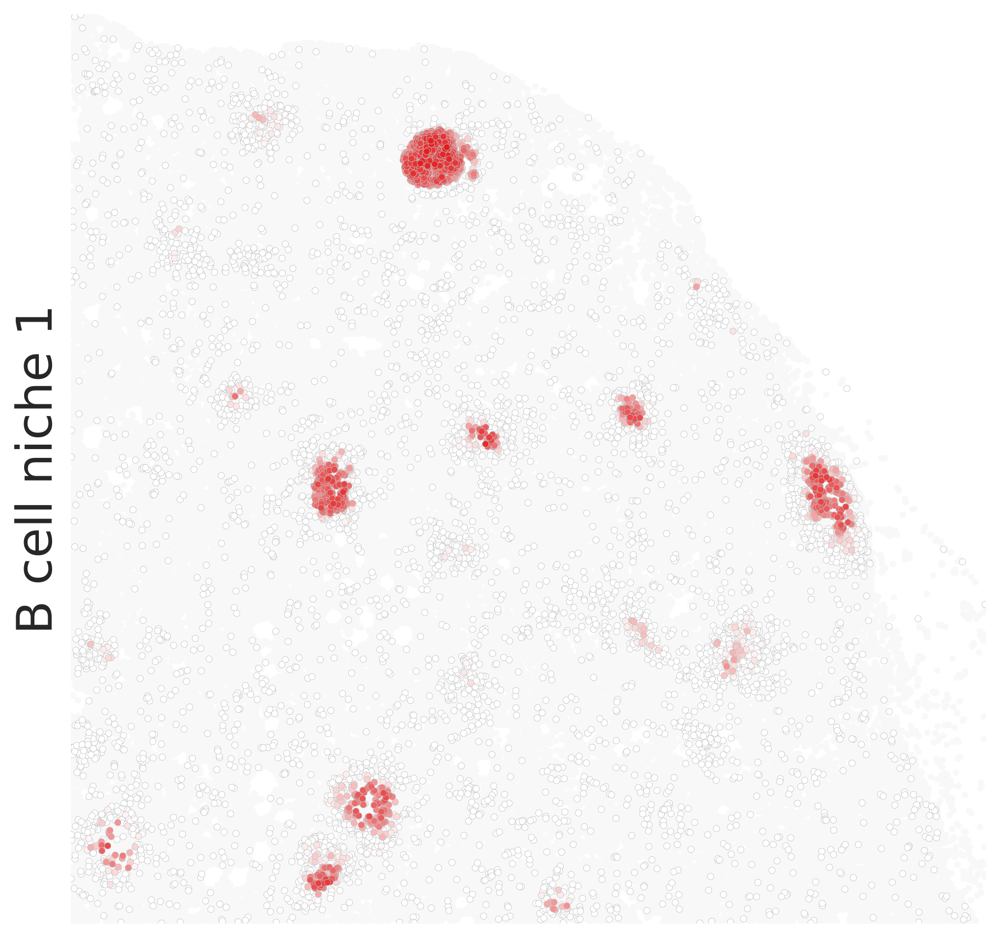

In [77]:
draw_niche_score_spatial(crop1, meta1['score_df'], 'S_comp2', target_ct='B', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=None, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='B cell niche 1', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

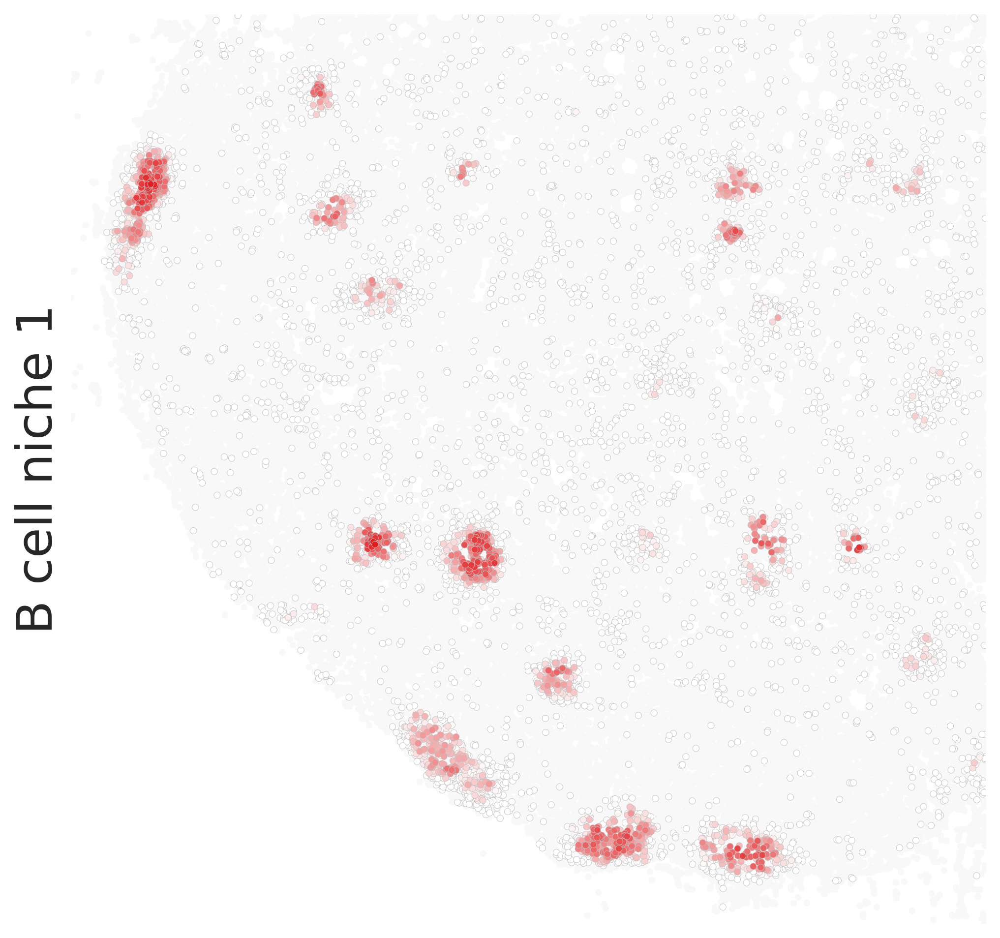

In [78]:
draw_niche_score_spatial(crop2, meta2['score_df'], 'S_comp2', target_ct='B', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=None, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='B cell niche 1', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)


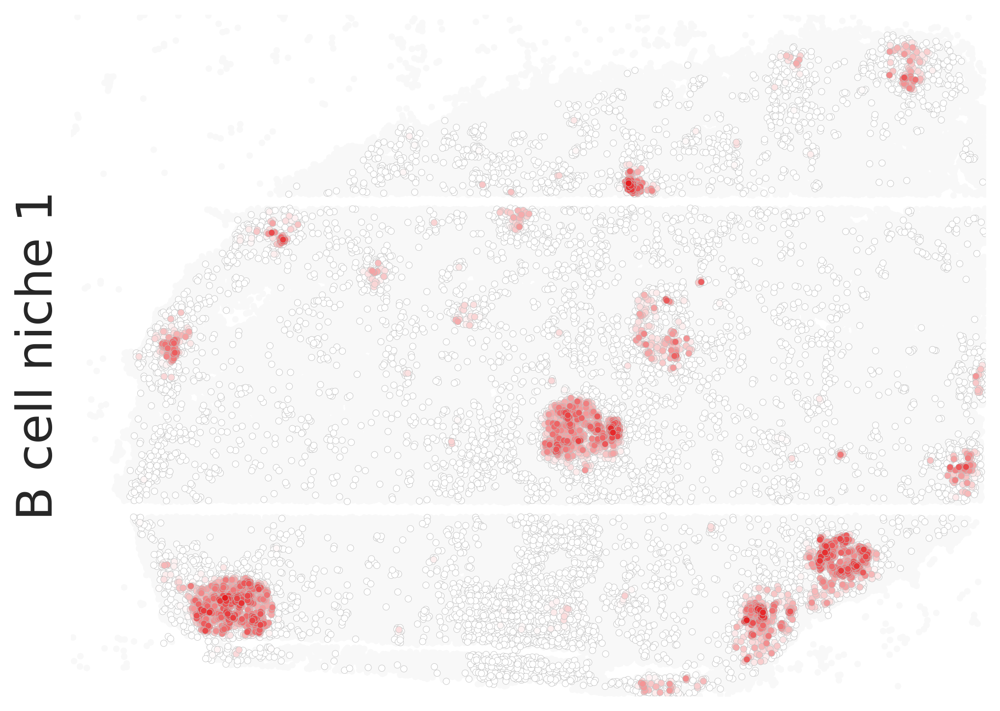

In [79]:
draw_niche_score_spatial(crop3, meta3['score_df'], 'S_comp3', target_ct='B', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=None, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='B cell niche 1', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,6), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=False)

### Niche 2

In [82]:
cmap_niche_score = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche_score', ['#FFFFFF', cmap_niche(1)])

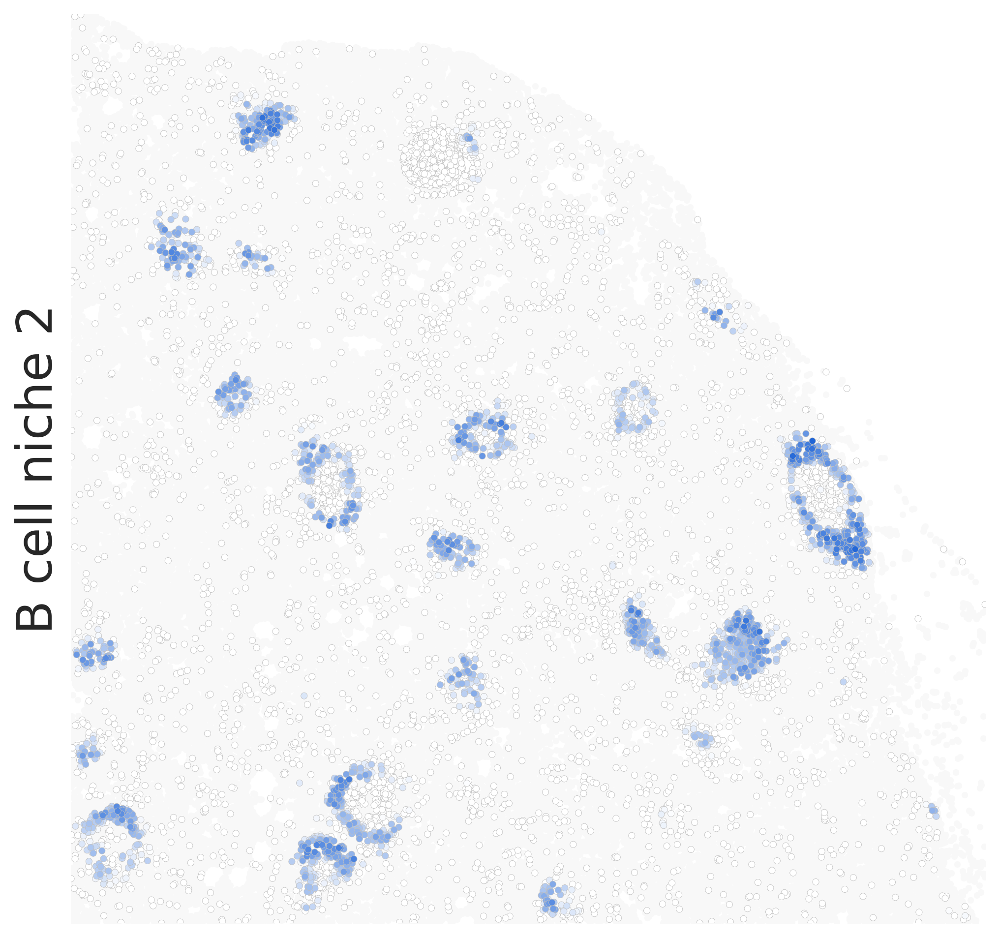

In [83]:
draw_niche_score_spatial(crop1, meta1['score_df'], 'S_comp7', target_ct='B', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=None, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='B cell niche 2', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

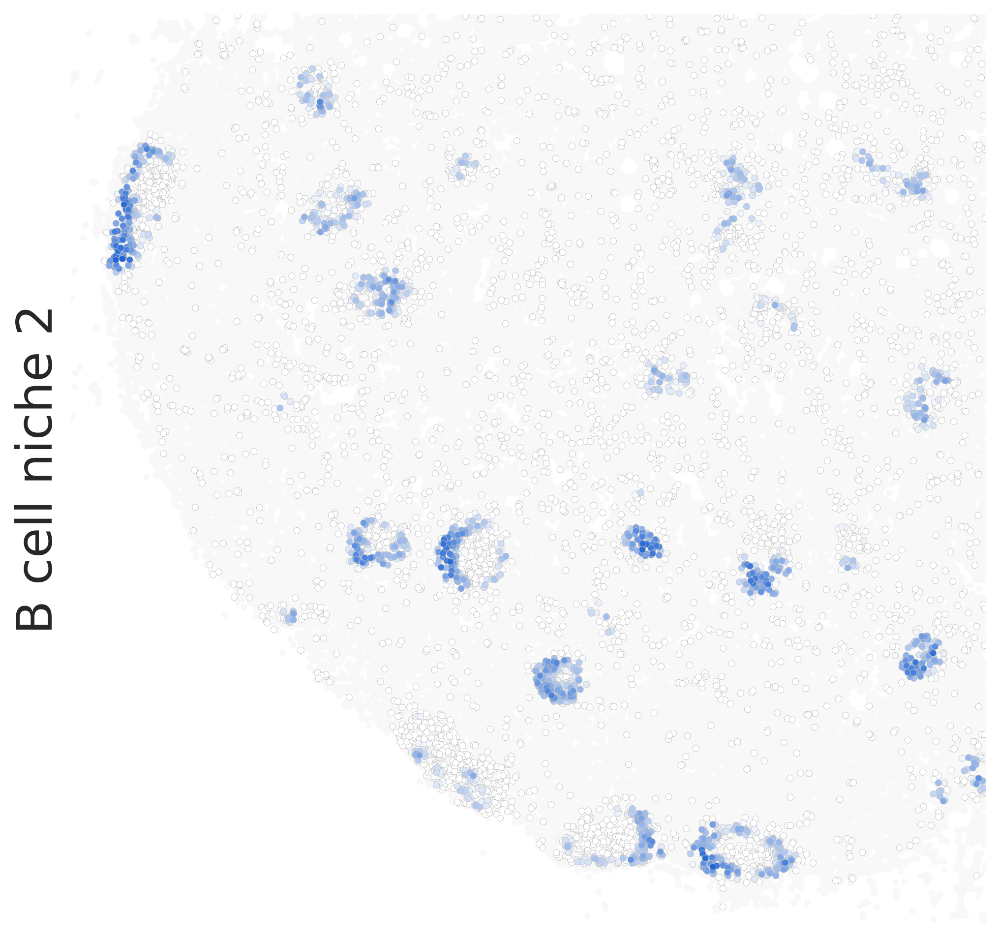

In [84]:
draw_niche_score_spatial(crop2, meta2['score_df'], 'S_comp6', target_ct='B', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=None, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='B cell niche 2', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

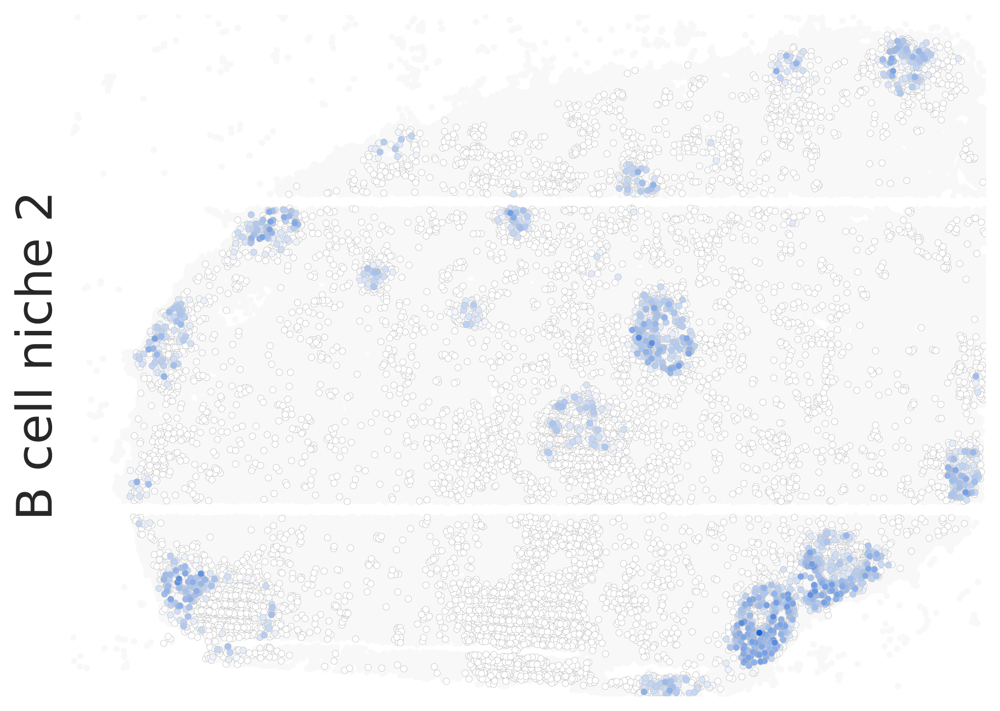

In [85]:
draw_niche_score_spatial(crop3, meta3['score_df'], 'S_comp4', target_ct='B', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=None, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='B cell niche 2', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,6), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=False)

## Niche genes
Combined gene coefficients of B cell niche 1 and niche 2 on three datasets.

In [88]:
## CCA components of niche 1 and 2
comps1 = [f'comp{x}' for x in [2, 7]]
comps2 = [f'comp{x}' for x in [2, 6]]
comps3 = [f'comp{x}' for x in [3, 4]] 
## combine gene coefficients of niche 1 and 2 on three datasets
df = pd.merge(udf1[comps1], udf2[comps2], how='outer', left_index=True, right_index=True).fillna(0)
df.columns = ['crop1_niche1', 'crop1_niche2', 'crop2_niche1', 'crop2_niche2']
df = pd.merge(df, udf3[comps3], how='outer', left_index=True, right_index=True).fillna(0)
df.columns = ['crop1_niche1', 'crop1_niche2', 'crop2_niche1', 'crop2_niche2', 'openst_niche1', 'openst_niche2']

## show top niche genes on crop 1 and crop 2, and several additional niche genes mentioned in main text,
## sort by [crop1_niche1, crop1_niche2]
n_top1, n_top2 = 15, 15
genes1 = df.sort_values('crop1_niche1', ascending=False).iloc[:n_top1].index.tolist()
genes2 = df.sort_values('crop1_niche2', ascending=False).iloc[:n_top2].index.tolist()
add_genes = ['PAX5', 'CD40', 'BCL6', 'BCL2L11', 'BACH2', 'SELL', 'CXCR5']
genes = sorted(set(genes1) | set(genes2) | set(add_genes))
ucolor_df0 = df[['crop1_niche1', 'crop2_niche1', 'openst_niche1', 'crop1_niche2', 'crop2_niche2', 'openst_niche2']].loc[genes]
ucolor_df0['sum'] = ucolor_df0['crop1_niche1'] + ucolor_df0['crop1_niche2']
ucolor_df0['max'] = np.maximum(ucolor_df0['crop1_niche1'], ucolor_df0['crop1_niche2'])
ucolor_df0 = ucolor_df0.sort_values(['crop1_niche1','crop1_niche2'], ascending=False)
ucolor_df0 = ucolor_df0.iloc[:,:6]
ucolor_df = ucolor_df0.stack().reset_index(name="u")
print(len(ucolor_df0))

34


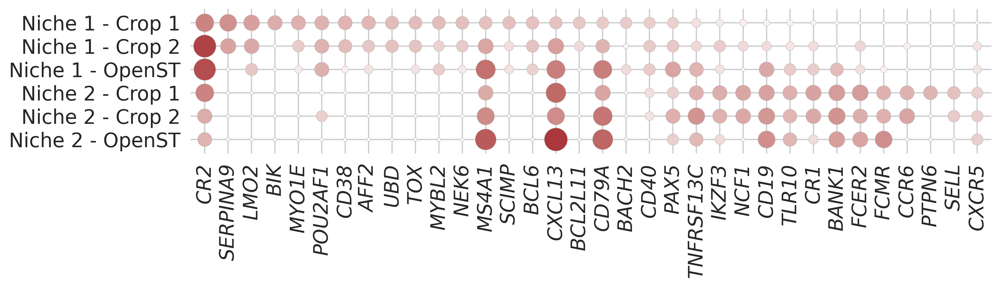

In [89]:
sns.set_theme(style="whitegrid", rc={"grid.linewidth": 1})
sns.set_context('paper', font_scale=1.)
plt.rcParams.update({"figure.dpi": 300, "grid.linewidth": 1.})
h = 3.5
w = 0.5*len(ucolor_df0)
fs = 16
sizes=(10, 350)
mx = 0.6/(len(ucolor_df0)-1)
my = 0.6/(6-1)
leg_pos=(1.03,0.95)
yticklabels = ['Niche 1 - Crop 1', 'Niche 1 - Crop 2', 'Niche 1 - OpenST', 
               'Niche 2 - Crop 1', 'Niche 2 - Crop 2', 'Niche 2 - OpenST']
title = None
csm = ucolor_df.u.max()
g = sns.relplot(
    data=ucolor_df, 
    x="level_0", y="level_1", hue="u", size="u",
    palette="vlag", hue_norm=(-csm, csm), edgecolor="0.7",
    height=h, aspect=3, sizes=sizes, size_norm=(0, csm), legend=True, 
)
g.set(xlabel="", ylabel="", yticklabels=yticklabels, title=title, aspect='equal')

g.set_xticklabels(size = fs, style='italic', rotation=90)
g.set_yticklabels(size = fs, rotation=0, ha='right')
g.despine(left=True, bottom=True)
g.ax.margins(x=mx, y=my)
g._legend.remove()

## Pathways
Niche 1 and 2 enriched pathways of corresponding niche genes.

In [90]:
enr_u_thres = 0.05
enr_n_top = 100
gene_sets = ['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2025','Reactome_2022']

print('Number of niche genes used for pathway enrichment analysis:')

## niche 1
# crop 1
comp = 'comp2'
glist = udf1.loc[udf1[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 1 - Crop 1: {len(glist)} genes')
enr11 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
# crop 2
comp = 'comp2'
glist = udf2.loc[udf2[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 1 - Crop 2: {len(glist)} genes')
enr12 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
# openst
comp = 'comp3'
glist = udf3.loc[udf3[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 1 - OpenST: {len(glist)} genes')
enr13 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)

## niche 2
# crop 1
comp = 'comp7'
glist = udf1.loc[udf1[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 2 - Crop 1: {len(glist)} genes')
enr21 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
# crop 2
comp = 'comp6'
glist = udf2.loc[udf2[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 2 - Crop 2: {len(glist)} genes')
enr22 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
# openst
comp = 'comp4'
glist = udf3.loc[udf3[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 2 - OpenST: {len(glist)} genes')
enr23 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)

Number of niche genes used for pathway enrichment analysis:
Niche 1 - Crop 1: 100 genes
Niche 1 - Crop 2: 100 genes
Niche 1 - OpenST: 96 genes
Niche 2 - Crop 1: 86 genes
Niche 2 - Crop 2: 71 genes
Niche 2 - OpenST: 45 genes


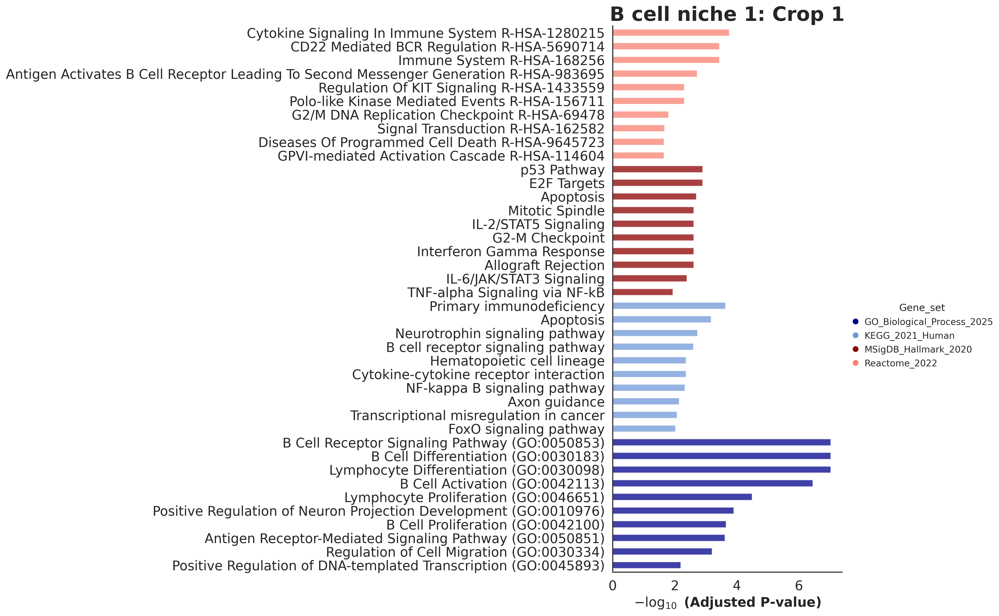

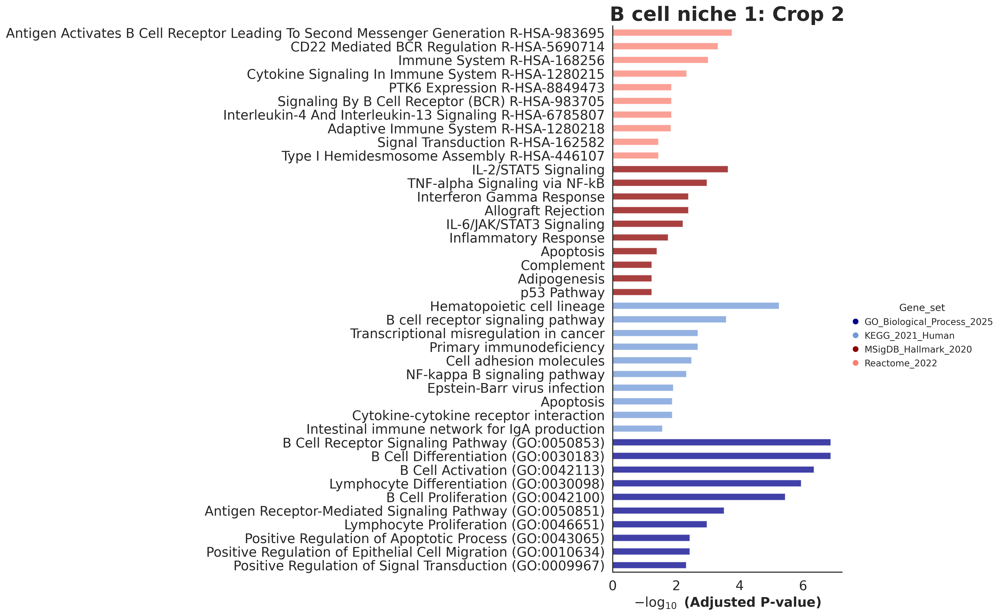

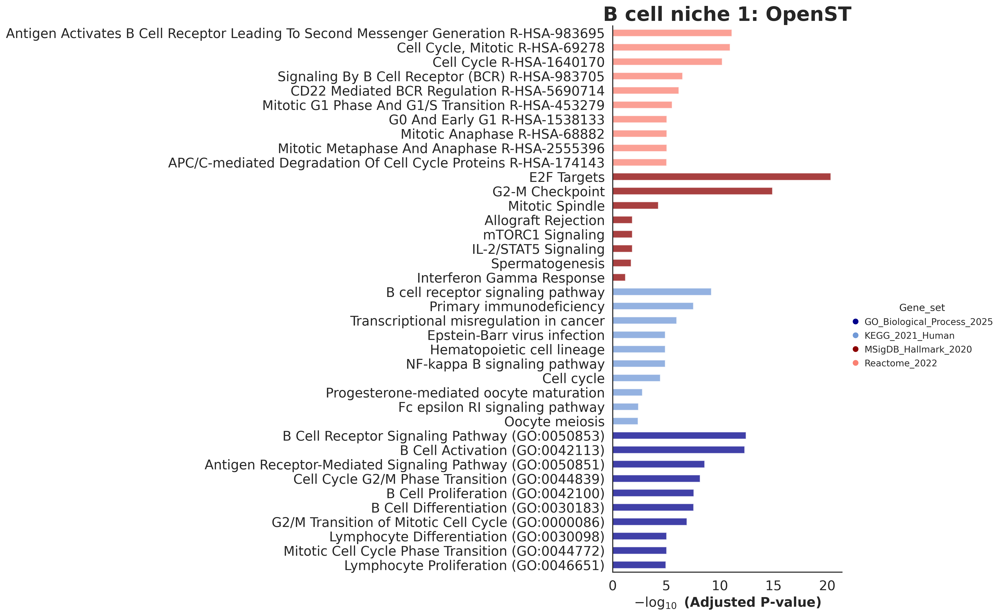

In [92]:
## niche 1
sns.set_theme(style='white')
for enr, dataset in zip([enr11, enr12, enr13], ['Crop 1', 'Crop 2', 'OpenST']):
    with mpl.rc_context({'figure.dpi': 300}):
        gseapy.barplot(enr.results,
                       title=f"B cell niche 1: {dataset}",
                       cutoff=0.1,
                       column="Adjusted P-value",
                       group='Gene_set', 
                       size=10,
                       top_term=10,
                       figsize=(5,12),
                       color=['darkblue','#7099d7','darkred','salmon'] 
                      )

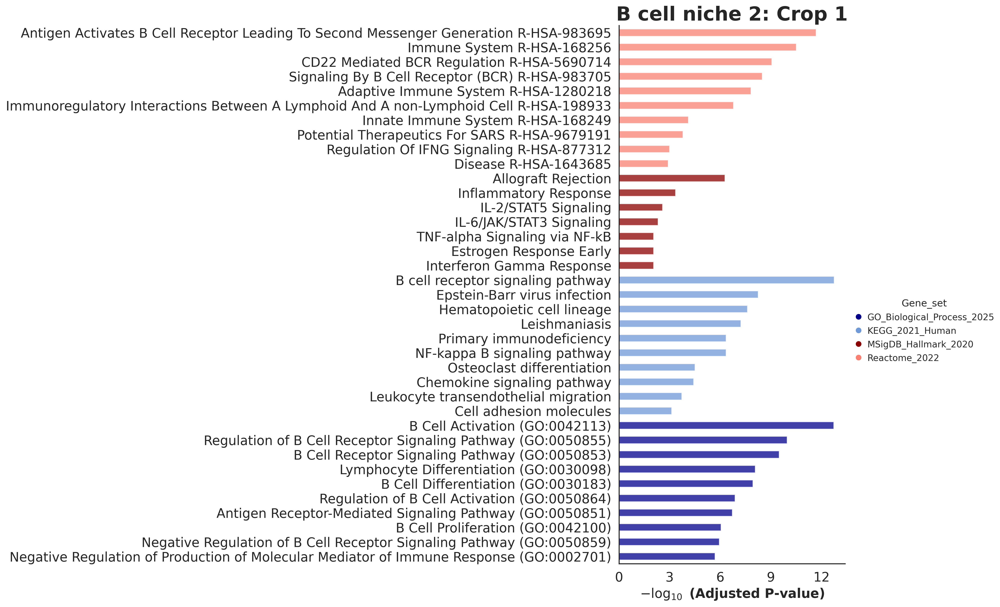

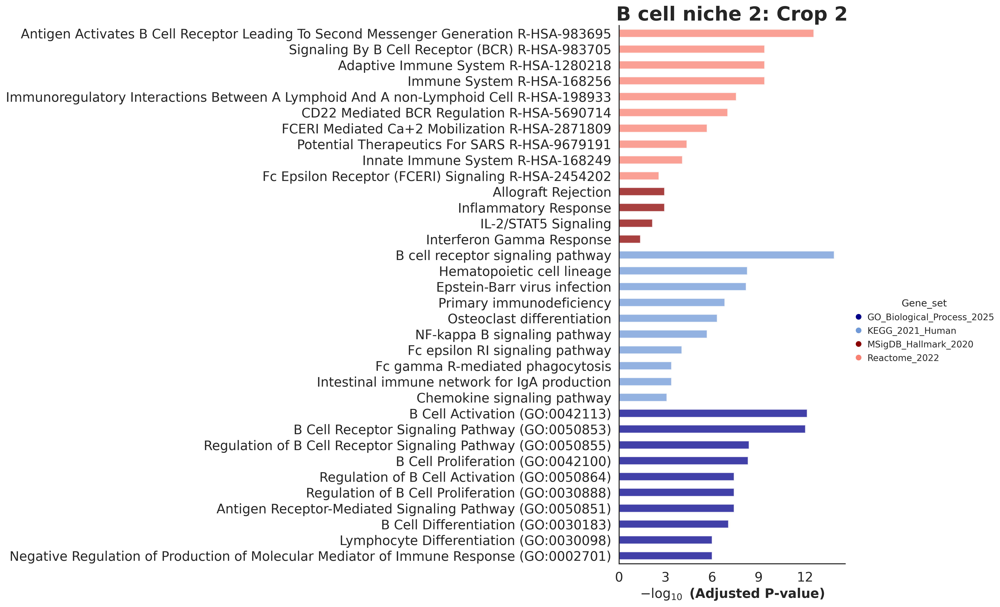

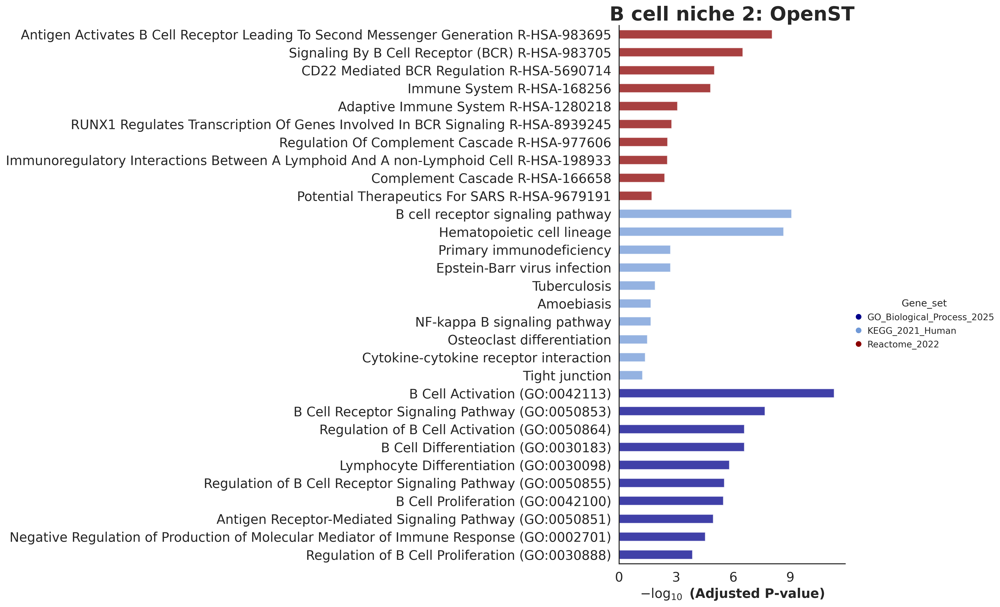

In [93]:
## niche 2
sns.set_theme(style='white')
for enr, dataset in zip([enr21, enr22, enr23], ['Crop 1', 'Crop 2', 'OpenST']):
    with mpl.rc_context({'figure.dpi': 300}):
        gseapy.barplot(enr.results,
                       title=f"B cell niche 2: {dataset}",
                       cutoff=0.1,
                       column="Adjusted P-value",
                       group='Gene_set', 
                       size=10,
                       top_term=10,
                       figsize=(5,12),
                       color=['darkblue','#7099d7','darkred','salmon'] 
                      )

In [104]:
## representative pathways significant in niche 1 or 2
# niche 1 
sel_terms1 = ['B Cell Differentiation (GO:0030183)',
              'B Cell Receptor Signaling Pathway (GO:0050853)',
              'B Cell Activation (GO:0042113)',
              'B Cell Proliferation (GO:0042100)',
              'Apoptosis']
# niche 2
sel_terms2 = ['B Cell Activation (GO:0042113)',
              'B Cell Receptor Signaling Pathway (GO:0050853)',
              'B Cell Differentiation (GO:0030183)',
              'B Cell Proliferation (GO:0042100)']
## for ordering terms
df1_ = enr11.results.loc[enr11.results.Gene_set.isin(['GO_Biological_Process_2025', 'MSigDB_Hallmark_2020'])]
df2_ = enr21.results.loc[enr21.results.Gene_set.isin(['GO_Biological_Process_2025', 'MSigDB_Hallmark_2020'])]
df1_ = df1_.loc[df1_.Term.isin(sel_terms1)].sort_values('Adjusted P-value').reset_index(drop=True)
df2_ = df2_.loc[df2_.Term.isin(sel_terms2)].sort_values('Adjusted P-value').reset_index(drop=True)
terms1 = df1_.Term.tolist()
terms2 = df2_.Term.tolist()
terms = terms1
for x in terms2:
    if x not in terms:
        terms.append(x)      
print(f'Show {len(terms)} representative pathways.')

## combine terms
columns = ['Niche 1-1', 'Niche 1-2', 'Niche 1-3', 'Niche 2-1', 'Niche 2-2', 'Niche 2-3']
comb_df0 = pd.DataFrame(0, index=terms, columns=columns)
for column, enr in zip(columns, [enr11, enr12, enr13, enr21, enr22, enr23]):
    df = enr.results.copy()
    df = df.loc[df.Term.isin(terms)].reset_index(drop=True)
    comb_df0.loc[df.Term, column] = -np.log10(df['Adjusted P-value'].values)
df0 = comb_df0.stack().reset_index(name='score')

Show 5 representative pathways.


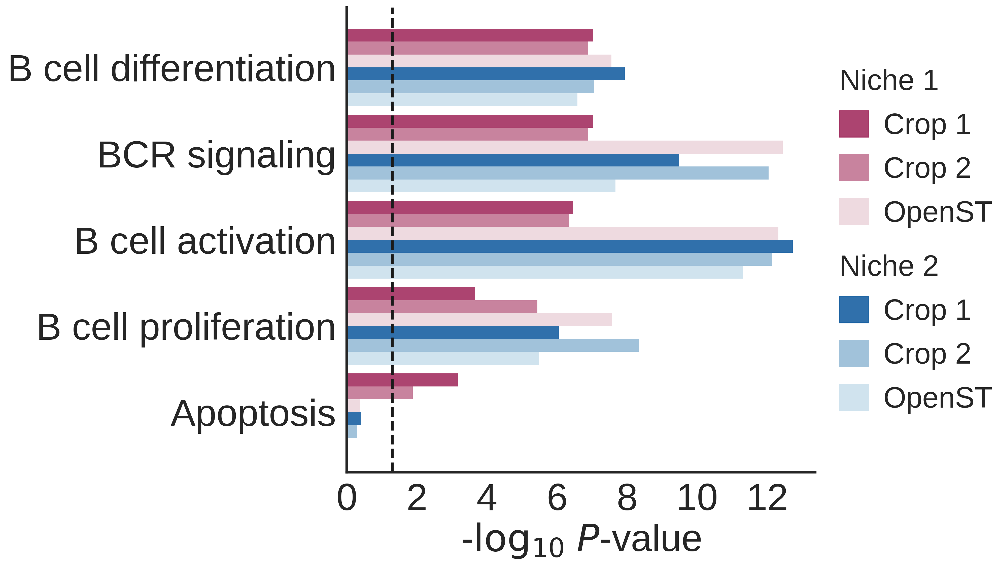

In [103]:
data = comb_df0.copy()
yticklabels = ['B cell differentiation', 
               'BCR signaling', 
               'B cell activation', 
               'B cell proliferation', 
               'Apoptosis']
unit_offset = 1
h = 1.5
ranges = np.arange(50,0,-10)
ranges11 = ranges + unit_offset * 2.5 * h
ranges12 = ranges + unit_offset * 1.5 * h
ranges13 = ranges + unit_offset * 0.5 * h
ranges21 = ranges - unit_offset * 0.5 * h
ranges22 = ranges - unit_offset * 1.5 * h
ranges23 = ranges - unit_offset * 2.5 * h
alpha = 0.5
lw = 0
tick_fs = 36
label_fs = 36
lgd_fs = 28
colors1 = ['#a32f61', '#d39db2', '#eedae0']
colors2 = ['#376eae', '#9DC1E0', '#D9E9F2']
colors1 = ['#a32f61', '#c8839e', '#eedae0']
colors2 = ['#1961a2', '#a1c2da', '#d0e3ee']

plt.style.use('seaborn-v0_8-white')
fig, ax = plt.subplots(1, 1, figsize=(8,8), dpi=300)
ax.axvline(-np.log10(0.05), ls='dashed', lw=2.5, color='k')
ax.barh(ranges11, data['Niche 1-1'].values, height=h, color=colors1[0], edgecolor=colors1[0], alpha=0.9, linewidth=lw)
ax.barh(ranges12, data['Niche 1-2'].values, height=h, color=colors1[1], edgecolor=colors1[1], alpha=1, linewidth=lw)
ax.barh(ranges13, data['Niche 1-3'].values, height=h, color=colors1[2], edgecolor=colors1[2], alpha=1, linewidth=lw)
ax.barh(ranges21, data['Niche 2-1'].values, height=h, color=colors2[0], edgecolor=colors2[0], alpha=0.9, linewidth=lw)
ax.barh(ranges22, data['Niche 2-2'].values, height=h, color=colors2[1], edgecolor=colors2[1], alpha=1, linewidth=lw)
ax.barh(ranges23, data['Niche 2-3'].values, height=h, color=colors2[2], edgecolor=colors2[2], alpha=1, linewidth=lw)

ax.set_yticks((ranges11+ranges23)/2)
ax.set_yticklabels(yticklabels, fontsize=tick_fs)
ax.set_xticks(np.arange(0,13,2))
ax.set_xticklabels(np.arange(0,13,2), fontsize=tick_fs)
ax.set_xlabel(r'-$\text{log}_{10}$ $P$-value', fontsize=label_fs)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
for side in ['bottom', 'left']:
    ax.spines[side].set_linewidth(2.5)
ax.tick_params(axis='both', pad=10)

## legend on the right
legend1_patches = [mpatches.Patch(color=colors1[0], label='Crop 1', alpha=0.9),
                   mpatches.Patch(color=colors1[1], label='Crop 2', alpha=1),
                   mpatches.Patch(color=colors1[2], label='OpenST', alpha=1)]
legend1 = ax.legend(handles=legend1_patches, loc='upper left', bbox_to_anchor=(1.02, 0.9), 
                    title='Niche 1', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)
ax.add_artist(legend1)
legend2_patches = [mpatches.Patch(color=colors2[0], label='Crop 1', alpha=0.9),
                   mpatches.Patch(color=colors2[1], label='Crop 2', alpha=1),
                   mpatches.Patch(color=colors2[2], label='OpenST', alpha=1)]
legend2 = ax.legend(handles=legend2_patches, loc='upper left', bbox_to_anchor=(1.02, 0.5), 
                    title='Niche 2', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)

## Sub cell type enrichment
Enrichment of subtypes of the target cell type within B cell niche 1 or 2 on Xenium two crops.

In [124]:
## compute enrichement fold
subcts = ['B_GC_LZ', 'B_GC_DZ', 'B_Cycling', 'B_activated', 'B_naive', 'B_preGC', 'B_IFN']
sub11 = sub_ct_enrich(2, meta1['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)
sub12 = sub_ct_enrich(2, meta2['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)
sub21 = sub_ct_enrich(7, meta1['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)
sub22 = sub_ct_enrich(6, meta2['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)

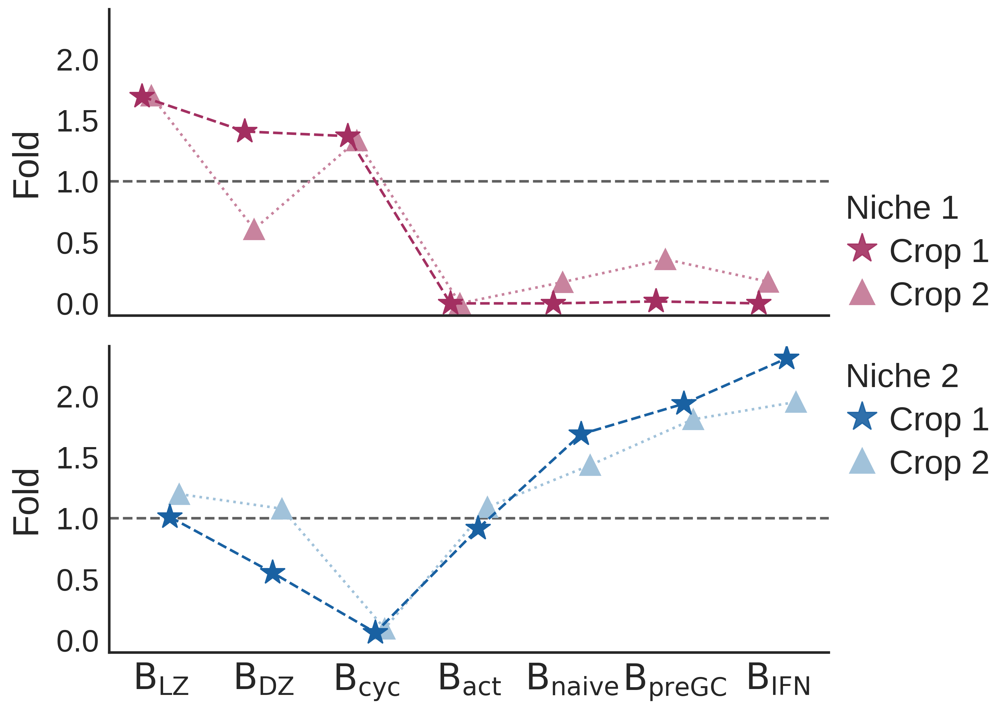

In [125]:
## plot
xranges = np.arange(len(subcts))
offset = 0.3
xranges11 = xranges - offset * 2 * offset
xranges12 = xranges - offset * 1 * offset
xranges21 = xranges + offset * 1 * offset
xranges22 = xranges + offset * 2 * offset
col = 'fold_09'
y11 = sub11.loc[subcts][col].values
y12 = sub12.loc[subcts][col].values
y21 = sub21.loc[subcts][col].values
y22 = sub22.loc[subcts][col].values
colors1 = ['#a32f61', '#c8839e']
colors2 = ['#1961a2', '#a1c2da']
markers = ['*', '^']

ms = [20, 16]
lw = 2
label_fs = 28
tick_fs = 24
lgd_fs = 26
ymax = np.max([np.max(y11), np.max(y12), np.max(y21), np.max(y22)])

fig, ax = plt.subplots(2, 1, figsize=(10,9), dpi=300)
ax[0].axhline(1, ls='dashed', lw=lw, color='#606060')
ax[1].axhline(1, ls='dashed', lw=lw, color='#606060')
ax[0].plot(xranges12, y12, marker=markers[1], ms=ms[1], ls='dotted', lw=lw, color=colors1[1], label='Crop 1')
ax[0].plot(xranges11, y11, marker=markers[0], ms=ms[0], ls='dashed', lw=lw, color=colors1[0], label='Crop 2')
ax[1].plot(xranges22, y22, marker=markers[1], ms=ms[1], ls='dotted', lw=lw, color=colors2[1], label='Crop 1')
ax[1].plot(xranges21, y21, marker=markers[0], ms=ms[0], ls='dashed', lw=lw, color=colors2[0], label='Crop 2')

for i in range(2):
    ax[i].set_xticks([])
    ax[i].set_xlim([-0.5, 6.5])
    ax[i].set_ylim([-0.1, ymax+0.1])
    ax[i].set_yticks(np.arange(0,2.1,0.5))
    ax[i].set_yticklabels(np.arange(0,2.1,0.5), fontsize=tick_fs)
    ax[i].set_ylabel('Fold', fontsize=label_fs, labelpad=10)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    for side in ['bottom', 'left']:
        ax[i].spines[side].set_linewidth(2)
    ax[i].tick_params(axis='both', pad=8)
ax[1].set_xticks(xranges)
ax[1].set_xticklabels([r"$\text{B}_{\text{LZ}}$",
                       r"$\text{B}_{\text{DZ}}$",
                       r"$\text{B}_{\text{cyc}}$",
                       r"$\text{B}_{\text{act}}$",
                       r"$\text{B}_{\text{naive}}$",
                       r"$\text{B}_{\text{preGC}}$",
                       r"$\text{B}_{\text{IFN}}$"], fontsize=label_fs, ha='center')
ms_scale = 1.2
legend1_patches = [mlines.Line2D([0], [0], marker=markers[0], ms=ms[0]*ms_scale, color=colors1[0], lw=0, label='Crop 1', alpha=0.9),
                   mlines.Line2D([0], [0], marker=markers[1], ms=ms[1]*ms_scale, color=colors1[1], lw=0, label='Crop 2', alpha=1)]
legend1 = ax[0].legend(handles=legend1_patches, loc='upper left', bbox_to_anchor=(1.0,0.45), handletextpad=0.3, labelspacing=0.3,
                    title='Niche 1', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)
legend2_patches = [mlines.Line2D([0], [0], marker=markers[0], ms=ms[0]*ms_scale, color=colors2[0], lw=0, label='Crop 1', alpha=0.9),
                   mlines.Line2D([0], [0], marker=markers[1], ms=ms[1]*ms_scale, color=colors2[1], lw=0, label='Crop 2', alpha=1)]
legend2 = ax[1].legend(handles=legend2_patches, loc='upper left', bbox_to_anchor=(1.0,1.0), handletextpad=0.3, labelspacing=0.3,
                    title='Niche 2', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)

plt.subplots_adjust(hspace=0.1)